In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
pd.set_option('display.max_rows',None)

In [2]:
df = pd.read_csv('kaggle_survey_2020_responses.csv')

C:\Users\Lenovo\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
df.head(10)

,Time from Start to Finish (seconds),Q1,Q2,Q3,Q4,Q5,Q6,Q7_Part_1,Q7_Part_2,Q7_Part_3,...,Q35_B_Part_2,Q35_B_Part_3,Q35_B_Part_4,Q35_B_Part_5,Q35_B_Part_6,Q35_B_Part_7,Q35_B_Part_8,Q35_B_Part_9,Q35_B_Part_10,Q35_B_OTHER
0,Duration (in seconds),What is your age (# years)?,What is your gender? - Selected Choice,In which country do you currently reside?,What is the highest level of formal education ...,Select the title most similar to your current ...,For how many years have you been writing code ...,What programming languages do you use on a reg...,What programming languages do you use on a reg...,What programming languages do you use on a reg...,...,"In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor..."
1,1838,35-39,Man,Colombia,Doctoral degree,Student,5-10 years,Python,R,SQL,...,NaN,NaN,NaN,TensorBoard,NaN,NaN,NaN,NaN,NaN,NaN
2,289287,30-34,Man,United States of America,Master’s degree,Data Engineer,5-10 years,Python,R,SQL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,860,35-39,Man,Argentina,Bachelor’s degree,Software Engineer,10-20 years,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
4,507,30-34,Man,United States of America,Master’s degree,Data Scientist,5-10 years,Python,NaN,SQL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,78,30-34,Man,Japan,Master’s degree,Software Engineer,3-5 years,Python,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,401,30-34,Man,India,Bachelor’s degree,Data Analyst,< 1 years,Python,R,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,748,22-24,Man,Brazil,Bachelor’s degree,Student,3-5 years,Python,R,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,171196,25-29,Woman,China,Master’s degree,Student,< 1 years,NaN,R,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,762,35-39,Man,Germany,Doctoral degree,Data Scientist,5-10 years,Python,NaN,SQL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df.shape

(20037, 355)

In [5]:
df.columns

Index(['Time from Start to Finish (seconds)', 'Q1', 'Q2', 'Q3', 'Q4', 'Q5',
       'Q6', 'Q7_Part_1', 'Q7_Part_2', 'Q7_Part_3',
       ...
       'Q35_B_Part_2', 'Q35_B_Part_3', 'Q35_B_Part_4', 'Q35_B_Part_5',
       'Q35_B_Part_6', 'Q35_B_Part_7', 'Q35_B_Part_8', 'Q35_B_Part_9',
       'Q35_B_Part_10', 'Q35_B_OTHER'],
      dtype='object', length=355)

In [6]:
ques = ['Q1','Q2','Q3','Q4','Q5','Q6','Q7','Q8','Q9','Q10','Q11','Q12','Q13','Q14','Q15','Q16','Q17','Q18','Q19','Q20','Q21',
        'Q22','Q23','Q24','Q25','Q26','Q27','Q28','Q29','Q30','Q31','Q32','Q33','Q34','Q35']

In [7]:
df_copy = df.copy()

In [8]:
reqd = [feature for feature in df.columns if feature in ques]
reqd

['Q1',
 'Q2',
 'Q3',
 'Q4',
 'Q5',
 'Q6',
 'Q8',
 'Q11',
 'Q13',
 'Q15',
 'Q20',
 'Q21',
 'Q22',
 'Q24',
 'Q25',
 'Q30',
 'Q32']

In [9]:
df_copy = df_copy[reqd]

In [10]:
df_copy.head()

,Q1,Q2,Q3,Q4,Q5,Q6,Q8,Q11,Q13,Q15,Q20,Q21,Q22,Q24,Q25,Q30,Q32
0,What is your age (# years)?,What is your gender? - Selected Choice,In which country do you currently reside?,What is the highest level of formal education ...,Select the title most similar to your current ...,For how many years have you been writing code ...,What programming language would you recommend ...,What type of computing platform do you use mos...,Approximately how many times have you used a T...,For how many years have you used machine learn...,What is the size of the company where you are ...,Approximately how many individuals are respons...,Does your current employer incorporate machine...,What is your current yearly compensation (appr...,Approximately how much money have you (or your...,Which of the following big data products (rela...,Which of the following business intelligence t...
1,35-39,Man,Colombia,Doctoral degree,Student,5-10 years,Python,"A cloud computing platform (AWS, Azure, GCP, h...",2-5 times,1-2 years,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,30-34,Man,United States of America,Master’s degree,Data Engineer,5-10 years,Python,A personal computer or laptop,2-5 times,1-2 years,"10,000 or more employees",20+,"We have well established ML methods (i.e., mod...","100,000-124,999","$100,000 or more ($USD)",PostgresSQL,Microsoft Power BI
3,35-39,Man,Argentina,Bachelor’s degree,Software Engineer,10-20 years,R,A personal computer or laptop,Never,I do not use machine learning methods,"1000-9,999 employees",0,No (we do not use ML methods),"15,000-19,999",$0 ($USD),NaN,NaN
4,30-34,Man,United States of America,Master’s degree,Data Scientist,5-10 years,Python,"A cloud computing platform (AWS, Azure, GCP, h...",2-5 times,3-4 years,250-999 employees,5-9,"We have well established ML methods (i.e., mod...","125,000-149,999","$10,000-$99,999",MySQL,NaN


In [11]:
df_copy=df_copy.drop(columns=['Q6','Q8','Q11','Q13','Q15','Q20','Q21','Q22','Q25','Q30','Q32'])
df_copy

,Q1,Q2,Q3,Q4,Q5,Q24
0,What is your age (# years)?,What is your gender? - Selected Choice,In which country do you currently reside?,What is the highest level of formal education ...,Select the title most similar to your current ...,What is your current yearly compensation (appr...
1,35-39,Man,Colombia,Doctoral degree,Student,NaN
2,30-34,Man,United States of America,Master’s degree,Data Engineer,"100,000-124,999"
3,35-39,Man,Argentina,Bachelor’s degree,Software Engineer,"15,000-19,999"
4,30-34,Man,United States of America,Master’s degree,Data Scientist,"125,000-149,999"
5,30-34,Man,Japan,Master’s degree,Software Engineer,NaN
6,30-34,Man,India,Bachelor’s degree,Data Analyst,NaN
7,22-24,Man,Brazil,Bachelor’s degree,Student,NaN
8,25-29,Woman,China,Master’s degree,Student,NaN
9,35-39,Man,Germany,Doctoral degree,Data Scientist,"70,000-79,999"


In [12]:
df_copy['AGE']=df_copy['Q1']
df_copy['SEX']=df_copy['Q2']
df_copy['COUNTRY']=df_copy['Q3']
df_copy['HIGHEST LEVEL OF FORMAL EDUCATION']=df_copy['Q4']
df_copy['OCCUPATION']=df_copy['Q5']
df_copy['SALARY']=df_copy['Q24']

df_copy = df_copy.drop(columns=['Q1','Q2','Q3','Q4','Q5','Q24'])
df_copy = df_copy.drop([0])

In [13]:
df_copy

,AGE,SEX,COUNTRY,HIGHEST LEVEL OF FORMAL EDUCATION,OCCUPATION,SALARY
1,35-39,Man,Colombia,Doctoral degree,Student,NaN
2,30-34,Man,United States of America,Master’s degree,Data Engineer,"100,000-124,999"
3,35-39,Man,Argentina,Bachelor’s degree,Software Engineer,"15,000-19,999"
4,30-34,Man,United States of America,Master’s degree,Data Scientist,"125,000-149,999"
5,30-34,Man,Japan,Master’s degree,Software Engineer,NaN
6,30-34,Man,India,Bachelor’s degree,Data Analyst,NaN
7,22-24,Man,Brazil,Bachelor’s degree,Student,NaN
8,25-29,Woman,China,Master’s degree,Student,NaN
9,35-39,Man,Germany,Doctoral degree,Data Scientist,"70,000-79,999"
10,22-24,Man,China,No formal education past high school,Student,NaN


In [14]:
df_copy.groupby(['SEX']).count()

,AGE,COUNTRY,HIGHEST LEVEL OF FORMAL EDUCATION,OCCUPATION,SALARY
SEX,,,,,
Man,15789,15789,15446,15218,8872
Nonbinary,52,52,50,48,20
Prefer not to say,263,263,256,245,131
Prefer to self-describe,54,54,53,53,23
Woman,3878,3878,3764,3713,1683


In [15]:
Man = len(df_copy[df_copy['SEX']=='Man'])
Woman = len(df_copy[df_copy['SEX']=='Woman'])
No_say = len(df_copy[df_copy['SEX']=='Prefer not to say'])
Self_describe=len(df_copy[df_copy['SEX']=='Prefer to self-describe'])
NB = len(df_copy[df_copy['SEX']=='Nonbinary'])

# Gender Distribution

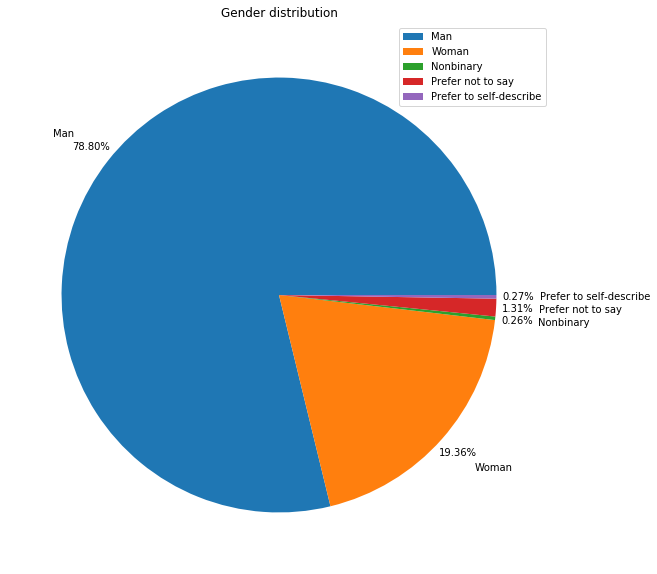

In [16]:
plt.figure(figsize=(10,10))
plt.pie([Man,Woman,NB,No_say,Self_describe],labels=['Man','Woman','Nonbinary','Prefer not to say',  'Prefer to self-describe',],autopct='%1.2f%%',pctdistance=1.1, labeldistance=1.2)
plt.legend(prop={'size':10})
plt.title('Gender distribution')
plt.show()

# Age Distribution

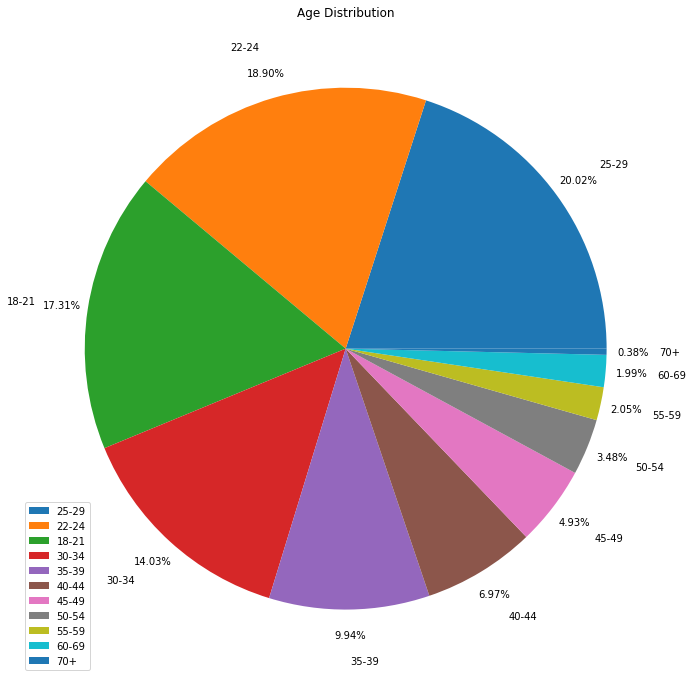

In [17]:
ages=df_copy['AGE'].value_counts()
plt.figure(figsize=(12,12))
plt.pie(ages,labels=ages.index,autopct='%1.2f%%',pctdistance=1.1, labeldistance=1.2)
plt.legend(prop={'size':10})
plt.title('Age Distribution')
plt.show()

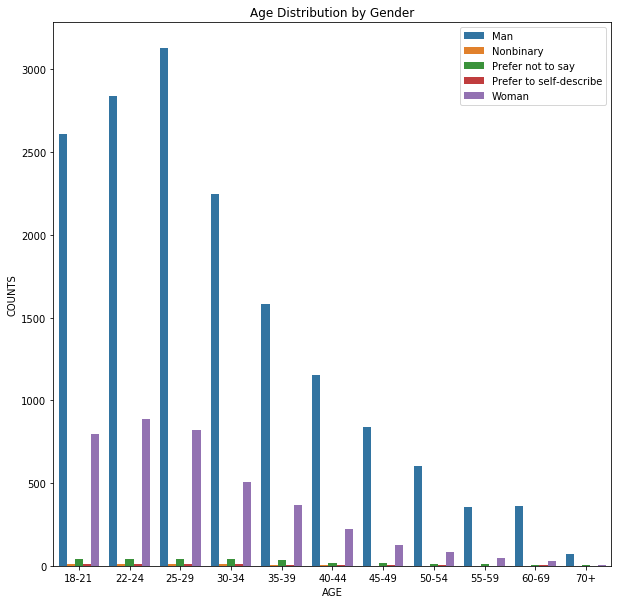

In [19]:
plt.figure(figsize=(10,10))
age_sex=df_copy.loc[:,["AGE", "SEX"]].groupby(["AGE", "SEX"]).size().reset_index()
age_sex.columns=['AGE','SEX','COUNTS']
sns.barplot(x="AGE", hue="SEX", y="COUNTS", data=age_sex)
plt.legend(loc='upper right')
plt.title('Age Distribution by Gender')
plt.show()

# Occupation

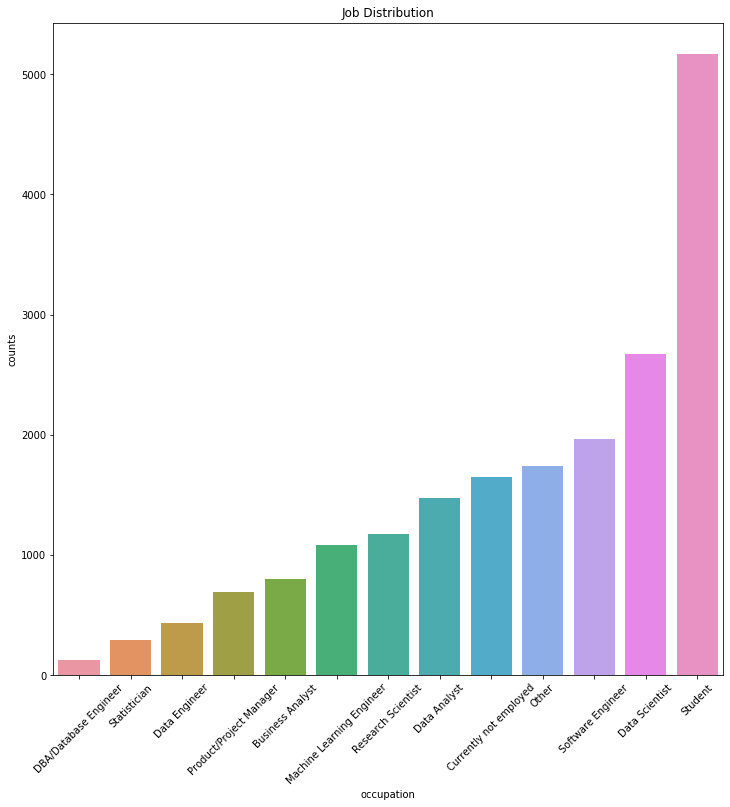

In [20]:
jobs=pd.DataFrame({'occupation':df_copy["OCCUPATION"].value_counts().index, 'counts':df_copy["OCCUPATION"].value_counts().values}).sort_values("counts")
plt.figure(figsize=(12,12))
sns.barplot(x='occupation',y='counts',data=jobs)
plt.title('Job Distribution')
plt.xticks(rotation=45)
plt.show()

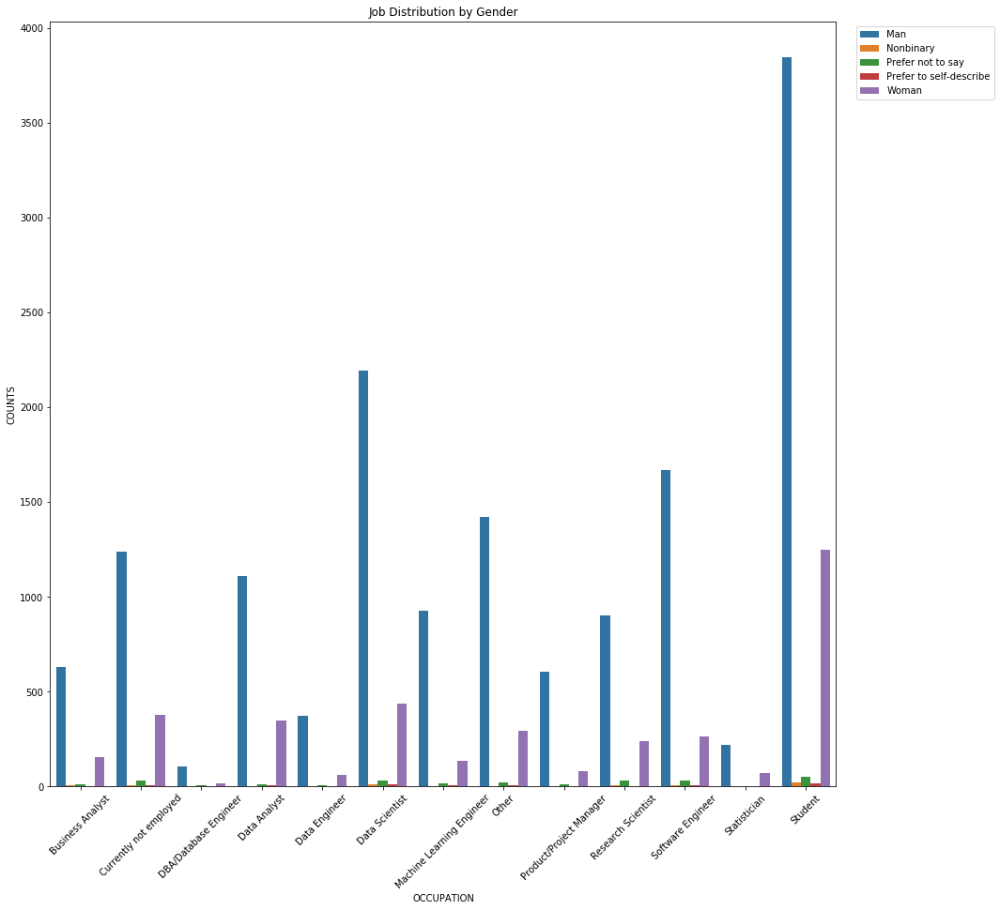

In [23]:
plt.figure(figsize=(15,15))
job_sex=df_copy.loc[:,["OCCUPATION", "SEX"]].groupby(["OCCUPATION", "SEX"]).size().reset_index()
job_sex.columns=['OCCUPATION','SEX','COUNTS']
sns.barplot(x="OCCUPATION", hue="SEX", y="COUNTS", data=job_sex)
plt.legend()
plt.title('Job Distribution by Gender')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()

# Education

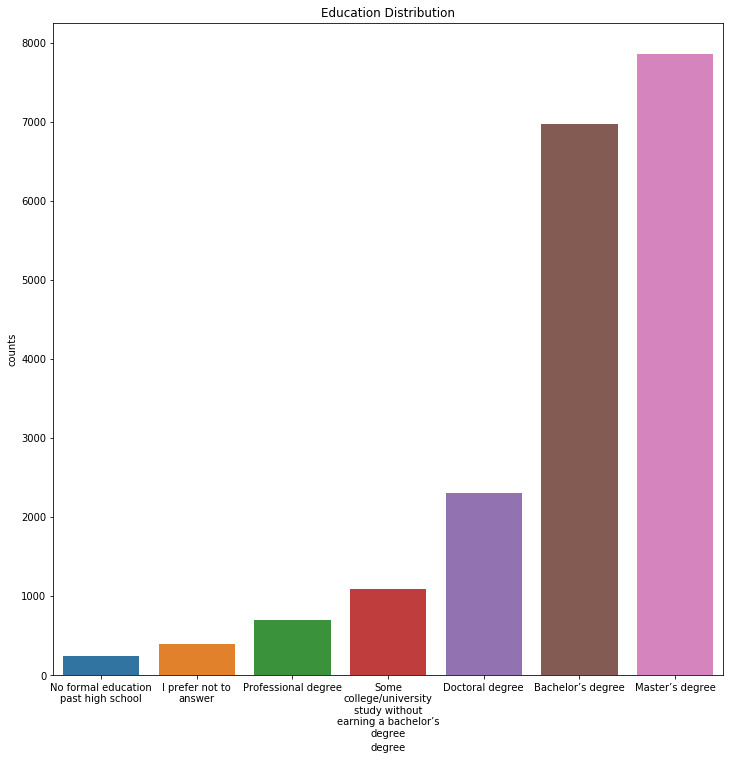

In [27]:
import textwrap
max_width = 20


education = pd.DataFrame({'degree':df_copy['HIGHEST LEVEL OF FORMAL EDUCATION'].value_counts().index,'counts':df_copy['HIGHEST LEVEL OF FORMAL EDUCATION'].value_counts().values}).sort_values('counts')
plt.figure(figsize=(12,12))
ax=sns.barplot(x='degree',y='counts',data=education)
ax.set_xticklabels(textwrap.fill(x.get_text(), max_width) for x in ax.get_xticklabels())
plt.title('Education Distribution')
plt.show()

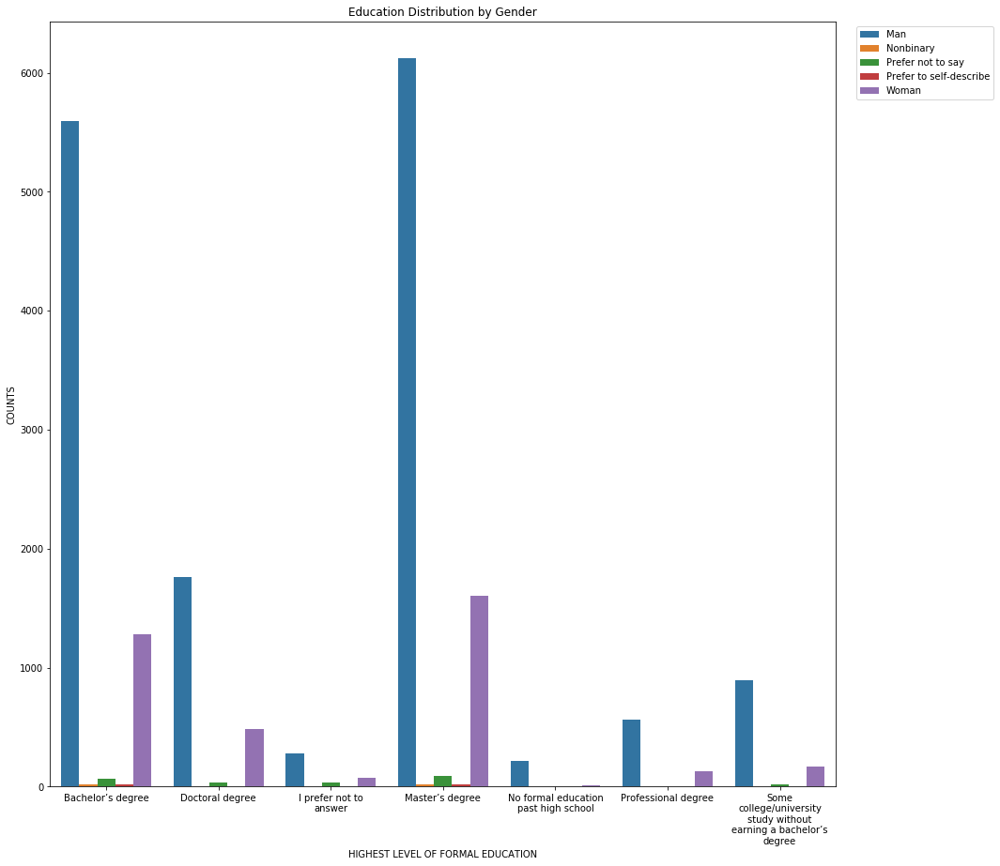

In [29]:

plt.figure(figsize=(15,15))
degree_sex=df_copy.loc[:,["HIGHEST LEVEL OF FORMAL EDUCATION", "SEX"]].groupby(["HIGHEST LEVEL OF FORMAL EDUCATION", "SEX"]).size().reset_index()
degree_sex.columns=['HIGHEST LEVEL OF FORMAL EDUCATION','SEX','COUNTS']
ax=sns.barplot(x="HIGHEST LEVEL OF FORMAL EDUCATION", hue="SEX", y="COUNTS", data=degree_sex)
plt.legend()
plt.title('Education Distribution by Gender')
ax.set_xticklabels(textwrap.fill(x.get_text(), max_width) for x in ax.get_xticklabels())
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()

# Salary

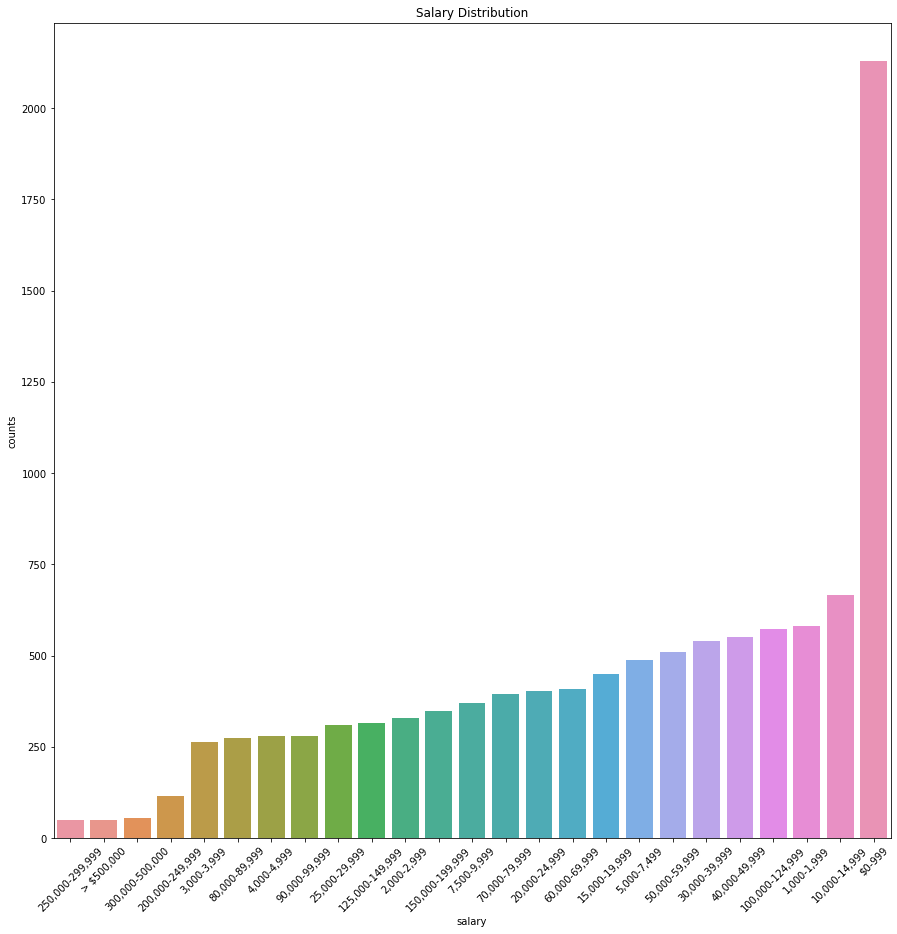

In [31]:
pay = pd.DataFrame({'salary':df_copy['SALARY'].value_counts().index,'counts':df_copy['SALARY'].value_counts().values}).sort_values('counts')
plt.figure(figsize=(15,15))
sns.barplot(x='salary',y='counts',data=pay)
plt.title('Salary Distribution')
plt.xticks(rotation=45)
plt.show()

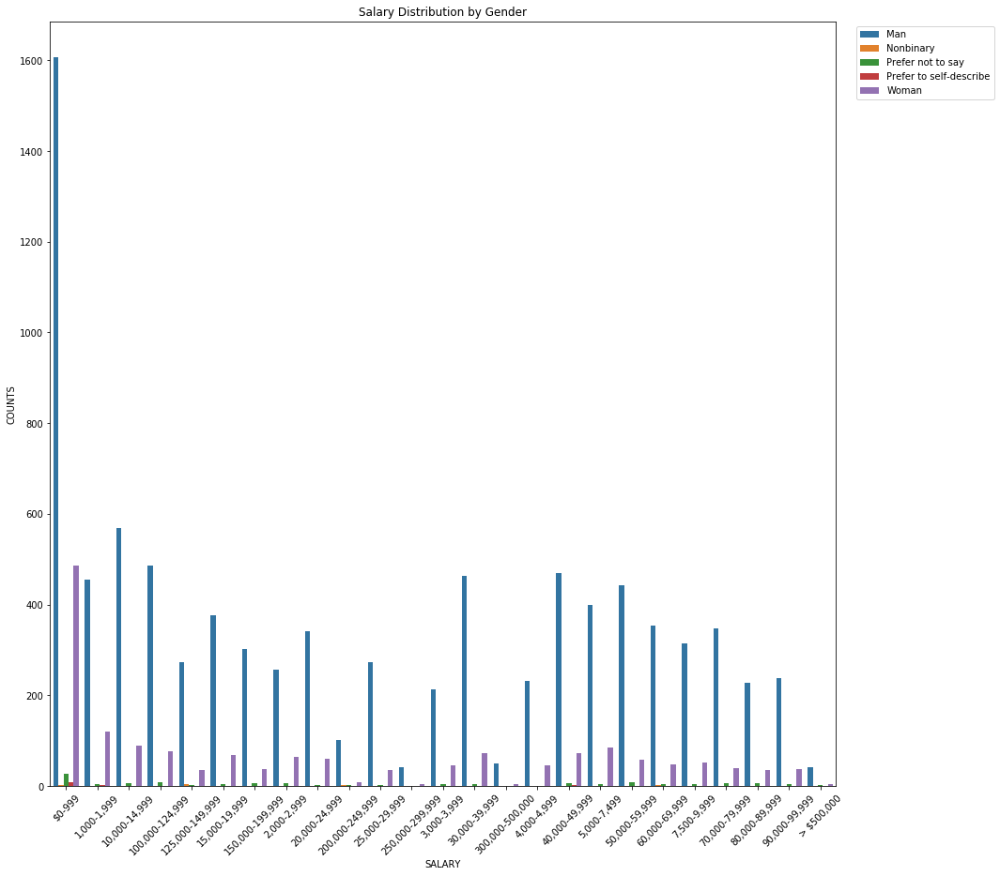

In [32]:
plt.figure(figsize=(15,15))
salary_sex=df_copy.loc[:,["SALARY", "SEX"]].groupby(["SALARY", "SEX"]).size().reset_index()
salary_sex.columns=['SALARY','SEX','COUNTS']
sns.barplot(x="SALARY", hue="SEX", y="COUNTS", data=salary_sex)
plt.legend()
plt.title('Salary Distribution by Gender')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()